# Please note that this notebook is not part of the analysis included in Marco Salas et al.
Yet it includes  additional metrics that might 


# Aim of the notebook

This notebook aims to define neighborhood diversity and density metrics for the cells profiled. This info is used in the comparison of imputation algorithms to test wether cellular density or diversity impact the performance of the imputation

In [44]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import xb.plotting as xp
import squidpy as sq

# Functions

In [103]:
def coexpression_calculation(exp,min_exp=0):
    coexpression=pd.DataFrame(index=exp.columns,columns=exp.columns)
    for col in tqdm(exp.columns):
        sel=exp.loc[:,col]>min_exp
        positive_cells=exp.loc[sel,:]
        coexpression.loc[:,col]=np.sum(positive_cells>min_exp)/positive_cells.shape[0]
    coexpression=coexpression.fillna(1)
    return coexpression

In [45]:
def format_data_neighs_radius(adata,sname,condit,radius=20):
    adata.obsm["spatial"]=np.array([adata.obs.X,adata.obs.Y]).transpose().astype('float64')
    adata.obs['sample']=sname
    adata_copy_int=adata
    sq.gr.spatial_neighbors(adata_copy_int,radius=radius,coord_type = 'generic')
    result=np.zeros([adata.shape[0],len(adata_copy_int.obs[sname].unique())])
    n=0
    tr=adata_copy_int.obsp['spatial_distances'].transpose()
    tr2=tr>0
    from tqdm import tqdm
    for g in tqdm(adata_copy_int.obs[sname].unique()):
        epv=adata_copy_int.obs[sname]==g*1
        opv=list(epv*1)
        result[:,n]=tr2.dot(opv)
        n=n+1
    expmat=pd.DataFrame(result,columns=adata_copy_int.obs[sname].unique())
    adata1=sc.AnnData(expmat,obs=adata.obs)
    adata1.obs['sample']=condit
    adata1.obs['condition']=condit
    return adata1


In [2]:
saving_path=r'../../data/processed_adata/'
adata=sc.read(saving_path+'/adata_multisection_nuclei_3rep_withHM_withclusters.h5ad')

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [21]:
#level of annotation to work on
annot='Class'
an_concat=[]
for ss in adata.obs['replicate'].unique():
    asub=adata[adata.obs['replicate']==ss]
    adataneigh=format_data_neighs_radius(asub,annot,ss,radius=100)
    an_concat.append(adataneigh)
adataneigh=sc.concat(an_concat)

100%|███████████████████████████████████████████████████████████████████████████████████| 50/50 [00:01<00:00, 46.64it/s]
/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:20: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
100%|███████████████████████████████████████████████████████████████████████████████████| 48/48 [00:00<00:00, 49.70it/s]
/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/ipykernel_launcher.py:20: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will

In [23]:
adata.obs['neighborhood_diversity']=np.sum(adataneigh.to_df()>0,axis=1)
adata.obs['neighborhood_density']=np.sum(adataneigh.to_df(),axis=1)

<Figure size 1080x1080 with 0 Axes>

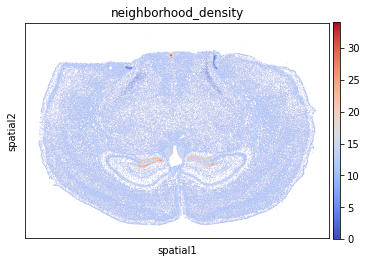

<Figure size 1080x1080 with 0 Axes>

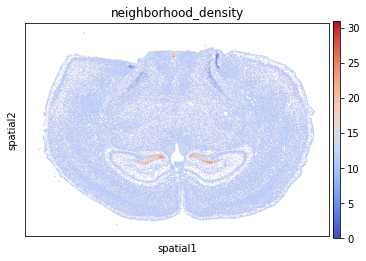

<Figure size 1080x1080 with 0 Axes>

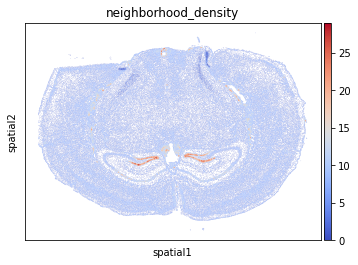

<Figure size 1080x1080 with 0 Axes>

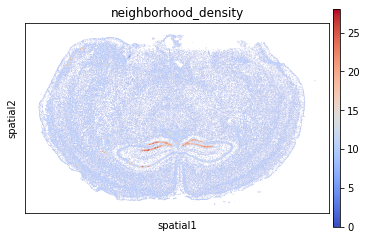

<Figure size 1080x1080 with 0 Axes>

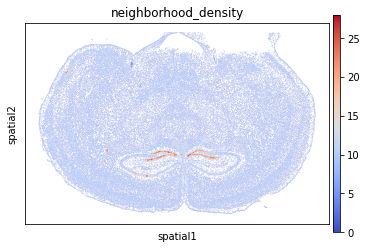

<Figure size 1080x1080 with 0 Axes>

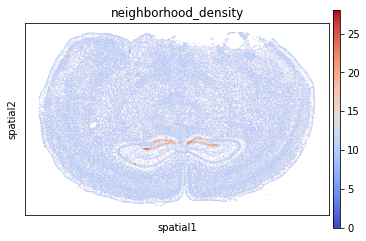

<Figure size 1080x1080 with 0 Axes>

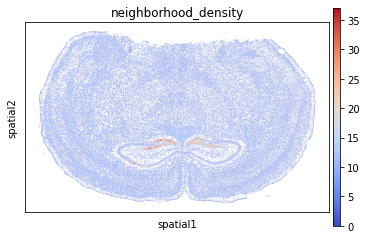

In [38]:
#level of annotation to work on
annot='Class'
for ss in adata.obs['replicate'].unique():
    asub=adata[adata.obs['replicate']==ss]
    asub.obsm['spatial']=np.array(asub.obs.loc[:,['X','Y']])
    plt.figure(figsize=(15,15))
    sc.pl.spatial(asub,color='neighborhood_density',spot_size=60,cmap='coolwarm')

<Figure size 1080x1080 with 0 Axes>

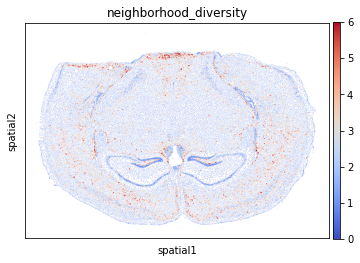

<Figure size 1080x1080 with 0 Axes>

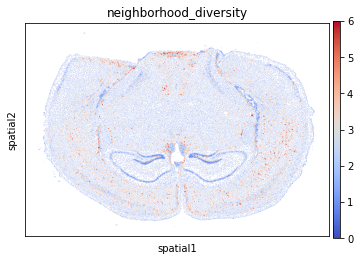

<Figure size 1080x1080 with 0 Axes>

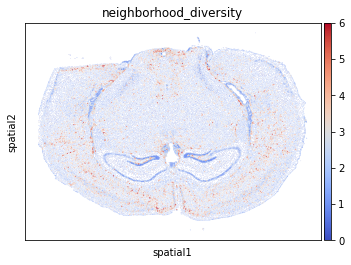

<Figure size 1080x1080 with 0 Axes>

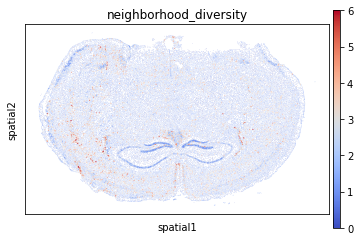

<Figure size 1080x1080 with 0 Axes>

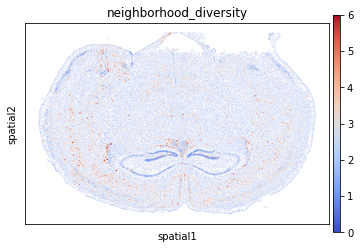

<Figure size 1080x1080 with 0 Axes>

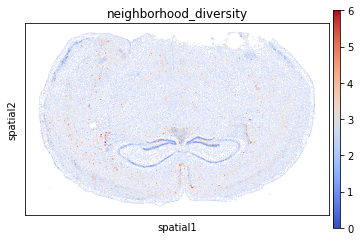

<Figure size 1080x1080 with 0 Axes>

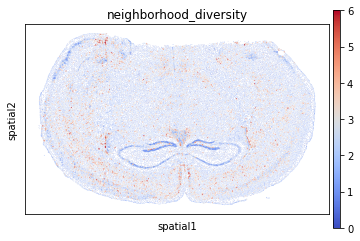

In [39]:
#level of annotation to work on
annot='Class'
for ss in adata.obs['replicate'].unique():
    asub=adata[adata.obs['replicate']==ss]
    asub.obsm['spatial']=np.array(asub.obs.loc[:,['X','Y']])
    plt.figure(figsize=(15,15))
    sc.pl.spatial(asub,color='neighborhood_diversity',spot_size=60,vmax=6,cmap='coolwarm')

In [48]:
adata_sp=adata

# Look at marker purity per cell

In [86]:
import scanpy as sc
import os
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import AnnData
def cell_specific_NMP_coexpression(adata_sp: AnnData, adata_sc: AnnData, key: str='celltype', pipeline_output: bool=True,minexp:float =0.0):
    """ Negative marker purity aims to measure read leakeage between cells in spatial datasets. 
    
    For this, we calculate the increase in reads assigned in spatial datasets to pairs of genes-celltyes with no/very low expression in scRNAseq
    
    Parameters
    ----------
    adata_sp : AnnData
        Annotated ``AnnData`` object with counts from spatial data
    adata_sc : AnnData
        Annotated ``AnnData`` object with counts scRNAseq data
    key : str
        Celltype key in adata_sp.obs and adata_sc.obs
    pipeline_output : float, optional
        Boolean for whether to use the function in the pipeline or not
    Returns
    -------
    negative marker purity : float
       Increase in proportion of reads assigned in spatial data to pairs of genes-celltyes with no/very low expression in scRNAseq
    """   
    
    # Set threshold parameters
    min_number_cells=10 #minimum number of cells belonging to a cluster to consider it in the analysis
    minimum_exp=0.05 #maximum relative expression allowed in a gene in a cluster to consider the gene-celltype pair the analysis 
    
    # Subset adata_sc to genes of spatial data
    adata_sp = adata_sp[:,adata_sp.var_names.isin(adata_sc.var_names)]
    adata_sc = adata_sc[:,adata_sp.var_names]
    # TMP fix for sparse matrices, ideally we don't convert, and instead have calculations for sparse/non-sparse
    #for a in [adata_sc, adata_sp]:
    #    if issparse(a.X):
    #        a.X = a.X.toarray()
    print(adata_sp.shape)
    print(adata_sc.shape)
    
    print(adata_sc.var.index)
    # Get mean expression per cell type
    try:
        exp_sc=pd.DataFrame(adata_sc.X.todense(),columns=adata_sc.var_names)
    except:
        exp_sc=pd.DataFrame(adata_sc.X,columns=adata_sc.var_names)
    try: 
        exp_sp = pd.DataFrame(adata_sp.X.todense(),columns=adata_sp.var_names)
    except:
        exp_sp = pd.DataFrame(adata_sp.X,columns=adata_sp.var_names)
    print(exp_sc.shape)
    #exp_sc['celltype'] = list(adata_sc.obs[key])
    #exp_sp['celltype'] = list(adata_sp.obs[key])
    # instead of measuring the purity by cell type, we check it based on the proportion of posive cells
    
    #mean_celltype_sc = exp_sc.groupby('celltype').mean()
    #mean_celltype_sp = exp_sp.groupby('celltype').mean()
    mean_celltype_sc=coexpression_calculation(exp_sc,min_exp=minexp)
    mean_celltype_sp=coexpression_calculation(exp_sp,min_exp=minexp)
    
    # Get mean expressions relative to mean over cell types (this will be used for filtering based on minimum_exp)
    mean_ct_sc_rel = mean_celltype_sc#.div(mean_celltype_sc.mean(axis=0),axis=1)
    mean_ct_sp_rel = mean_celltype_sp#.div(mean_celltype_sp.mean(axis=0),axis=1)
    
    # Get normalized mean expressions over cell types (this will be summed up over negative cell types)
    mean_ct_sc_norm = mean_celltype_sc#.div(mean_celltype_sc.sum(axis=0),axis=1)
    mean_ct_sp_norm = mean_celltype_sp#.div(mean_celltype_sp.sum(axis=0),axis=1)
    # Explanation: The idea is to measure which ratio of mean expressions is shifted towards negative clusters.
    #              With this approach the metric stays between 0 and 1
    
    commongenes=mean_ct_sc_rel.index
    # Get gene-cell type pairs with negative marker expression
    neg_marker_mask = np.array(mean_ct_sc_rel < minimum_exp)
    sns.clustermap(mean_ct_sc_rel.astype(float),vmax=0.1)
    # Return nan if no negative markers were found
    if np.sum(neg_marker_mask) < 1:
        print("No negative markers were found in the sc data reference.")
        negative_marker_purity = 'nan'
        if pipeline_output==True:
            return negative_marker_purity
        else:
            return negative_marker_purity, None, None
    
    # Get marker expressions in negative marker-cell type pairs
    lowvals_sc = np.full_like(neg_marker_mask, np.nan, dtype=np.float32)
    lowvals_sc = mean_ct_sc_norm.values[neg_marker_mask]
    lowvals_sp = mean_ct_sp_norm.values[neg_marker_mask]
    
    # Take the mean over the normalized expressions of the genes' negative cell types
    mean_sc_lowexp = np.nanmean(lowvals_sc)
    mean_sp_lowexp = np.nanmean(lowvals_sp)
    
    # Calculate summary metric
    #negative_marker_purity = 1
    #if mean_sp_lowexp > mean_sc_lowexp:
    #    negative_marker_purity -= (mean_sp_lowexp - mean_sc_lowexp)
    lowvals_diff=(lowvals_sp-lowvals_sc)
    lowvals_diff[lowvals_diff<0]=0
    negative_marker_purity=1-np.mean(lowvals_diff)
    
    
    
    
    if pipeline_output:
        return negative_marker_purity
    else:
        # Calculate per gene and per cell type purities
        purities = (mean_ct_sp_norm - mean_ct_sc_norm)#.cip(0,None)
        purities[~neg_marker_mask] = np.nan
        purities = purities.loc[~(purities.isnull().all(axis=1)), ~(purities.isnull().all(axis=0))]
        purity_per_gene = purities.mean(axis=0, skipna=True)
        purity_per_celltype = purities.mean(axis=1, skipna=True)
        return negative_marker_purity, purity_per_gene, purity_per_celltype,lowvals_sc,lowvals_sp,commongenes

    
def coexpression_calculation(exp,min_exp=0):
    coexpression=pd.DataFrame(index=exp.columns,columns=exp.columns)
    for col in tqdm(exp.columns):
        sel=exp.loc[:,col]>min_exp
        positive_cells=exp.loc[sel,:]
        coexpression.loc[:,col]=np.sum(positive_cells>min_exp)/positive_cells.shape[0]
    coexpression=coexpression.fillna(1)
    return coexpression


ModuleNotFoundError: No module named 'AnnData'

In [88]:
def median_calculator_Xenium(adata_dict,df_filt):
    gg=['anno_scRNAseq','anno_r1_multisection_Xenium']
    genes_s  = {
        'anno_scRNAseq': [],
         'anno_starmap': [],
         'anno_allen_smfish': [],
         'anno_allen_merFISH': [],
        'anno_Hybriss': [],
         'anno_osmfish':[],
         'anno_seqFISH': [],
         'anno_exseq': [],
         'anno_vizgen':[],
         'anno_baristaseq': [],
         'anno_r1_multisection_Xenium': [],
        'anno_ResolveBio': [],
        'anno_CosMx': [],
    }
    means  = {
        'anno_scRNAseq': [],
         'anno_starmap': [],
         'anno_allen_smfish': [],
         'anno_allen_merFISH': [],
        'anno_Hybriss': [],
         'anno_osmfish':[],
         'anno_seqFISH': [],
         'anno_exseq': [],
         'anno_vizgen':[],
         'anno_baristaseq': [],
         'anno_r1_multisection_Xenium': [],
        'anno_ResolveBio': [],
        'anno_CosMx': [],
    }
    for i,gene in tqdm(enumerate(df_filt.index)):
        RNA_S=[]
        print(gene)
        if np.sum(adata_dict['anno_scRNAseq'][:, adata_dict['anno_scRNAseq'].var.index == (gene)].X>minreads)>0:
            for key in gg:
                if key == 'anno_scRNAseq':
                    rna_subset = adata_dict[key][:, adata_dict[key].var.index == (gene)]
                    rna_median = np.median(list(rna_subset.X[rna_subset.X > minreads]))
                else:
                    if gene in adata_dict[key].var.index:
                        subset = adata_dict[key][:, adata_dict[key].var.index == (gene)]
                        median_exp = np.median(subset.X[subset.X > minreads])
                        #median_exp/rna_median
                        df_int = pd.DataFrame(subset.X[subset.X > minreads])
                        df_int['method'] = key
                        df_int[0].mean()/rna_median
                        RNA_S.append(df_int)
                        means[key].append(df_int[0].mean()/rna_median)
                        genes_s[key].append(gene)
                    if len(RNA_S) < 1:
                        continue
                    else:
                        RNA_df = pd.concat(RNA_S)
                        RNA_df=RNA_df.reset_index()

                    #means[key].append(df_int[0].mean()/rna_median)

            RNA_df['color'] = RNA_df.method.map(color_dicitonary)
            #UNCOMMENT TO GET THE PLOT
        #    sns.displot(data=RNA_df,x=RNA_df[0],hue='method',kind='ecdf',log_scale=True, palette=list(RNA_df['color'].unique()))
        #    plt.title(gene)
        #    plt.show()
        #UNTIL HERE
    return means,genes_s

In [46]:
#reread single cell data since we need the updated version
adata_sc=sc.read('/media/sergio/xenium_b_and_heart/Xenium_benchmarking-main/data/scRNAseq/WMB-10Xv2-subset02_ready_for_xenium_benchmark.h5ad')

In [76]:
# format single cell data accordingly
adata_sc.var.index=list(adata_sc.var['gene_symbol'])
gjn=adata_sc.var.groupby(adata_sc.var.index).count().sort_values(by='name')
# exclude duplicated genes
adata_sc=adata_sc[:,adata_sc.var.index.isin(gjn.index[gjn['name']==1])]
adata_sp.var_names=[x.lower() for x in adata_sp.var_names]
adata_sc.var_names=[x.lower() for x in adata_sc.var_names]

# Save the objects in adatadict

In [79]:
adata_dict={}
adata_dict['anno_scRNAseq']=adata_sc
adata_dict['anno_r1_multisection_Xenium']=adata_sp

In [80]:
repeated=[]
for variable in adata_dict['anno_scRNAseq'].var.index:
    #print(variable)
    rep=0
    for key in adata_dict.keys():
        if variable in adata_dict[key].var.index: 
            rep = rep+1
    repeated.append(rep)
import pandas as pd
df = pd.DataFrame(repeated)
df.index= adata_dict['anno_scRNAseq'].var.index

In [82]:
df_filt=df[df[0]>1]

In [90]:
color_dicitonary = {
'anno_scRNAseq': 'black',
 'anno_starmap': 'red',
 'anno_allen_smfish': 'purple',
 'anno_allen_merFISH': 'orangered',
    'anno_Hybriss': 'limegreen',
 'anno_osmfish': 'yellow',
 #'anno_seqFISH': 'cyan',
 'anno_exseq': 'brown',
 'anno_vizgen': '#E220F5',
 'anno_baristaseq': 'orange',
 'anno_r1_multisection_Xenium': 'steelblue',
'anno_ResolveBio':'forestgreen', 
    'anno_CosMx':'cyan'}
minreads=1
# Calculate mean ratios
means,genes_s=median_calculator_Xenium(adata_dict,df_filt)

0it [00:00, ?it/s]

sox17


1it [00:06,  6.07s/it]

col19a1


2it [00:12,  6.07s/it]

2010300c02rik


3it [00:18,  6.08s/it]

satb2


4it [00:24,  6.07s/it]

nrp2


5it [00:30,  6.07s/it]

spag16


6it [00:37,  6.33s/it]

vwc2l


7it [00:43,  6.25s/it]

fn1


8it [00:49,  6.17s/it]

igfbp5


9it [00:55,  6.12s/it]

epha4


10it [01:01,  6.12s/it]

dner


11it [01:07,  6.13s/it]

cntnap5b


12it [01:13,  6.09s/it]

cdh20


13it [01:19,  6.09s/it]

rnf152


14it [01:25,  6.07s/it]

tmem163


15it [01:31,  6.09s/it]

fmod


16it [01:37,  6.06s/it]

syt2


17it [01:43,  6.05s/it]

opn3


18it [01:49,  6.03s/it]

prox1


19it [01:55,  6.05s/it]

slc39a12


20it [02:01,  6.04s/it]

gad2


21it [02:07,  6.01s/it]

fibcd1


22it [02:13,  6.00s/it]

garnl3


23it [02:19,  6.00s/it]

lypd6


24it [02:25,  6.04s/it]

rprm


25it [02:31,  6.03s/it]

tanc1


26it [02:37,  6.02s/it]

fign


27it [02:43,  6.00s/it]

cobll1


28it [02:49,  6.00s/it]

nostrin


29it [02:56,  6.03s/it]

gad1


30it [03:02,  6.02s/it]

hat1


31it [03:08,  6.01s/it]

pde11a


32it [03:13,  6.00s/it]

spi1


33it [03:20,  6.04s/it]

cd44


34it [03:26,  6.00s/it]

bdnf


35it [03:31,  5.99s/it]

meis2


36it [03:37,  5.99s/it]

pdyn


37it [03:43,  5.98s/it]

lamp5


38it [03:50,  6.01s/it]

cd93


39it [03:55,  6.00s/it]

syndig1


40it [04:01,  5.99s/it]

cbln4


41it [04:07,  5.99s/it]

cdh4


42it [04:14,  6.04s/it]

bhlhe22


43it [04:20,  6.03s/it]

crh


44it [04:26,  6.01s/it]

mecom


45it [04:32,  6.00s/it]

kcnmb2


46it [04:38,  5.99s/it]

trpc4


47it [04:44,  6.03s/it]

plch1


48it [04:50,  6.00s/it]

rxfp1


49it [04:56,  6.01s/it]

gucy1a1


50it [05:02,  6.01s/it]

npy2r


51it [05:08,  6.04s/it]

syt6


52it [05:14,  6.03s/it]

cd53


53it [05:20,  6.03s/it]

dpyd


54it [05:26,  6.01s/it]

ndst3


55it [05:32,  6.01s/it]

ndst4


56it [05:38,  6.05s/it]

npnt


57it [05:44,  6.02s/it]

emcn


58it [05:50,  6.00s/it]

adgrl4


59it [05:56,  5.99s/it]

slc44a5


60it [06:02,  6.04s/it]

penk


61it [06:08,  6.02s/it]

tox


62it [06:14,  6.01s/it]

necab1


63it [06:20,  6.02s/it]

calb1


64it [06:26,  6.03s/it]

adamtsl1


65it [06:32,  6.08s/it]

ror1


66it [06:38,  6.05s/it]

rab3b


67it [06:44,  6.03s/it]

rims3


68it [06:50,  6.03s/it]

pou3f1


69it [06:56,  6.01s/it]

rspo1


70it [07:02,  6.05s/it]

grik3


71it [07:08,  6.02s/it]

laptm5


72it [07:14,  6.01s/it]

igsf21


73it [07:20,  6.00s/it]

cort


74it [07:26,  6.04s/it]

trp73


75it [07:32,  6.01s/it]

sema3d


76it [07:38,  6.00s/it]

sema3a


77it [07:44,  6.01s/it]

sema3e


78it [07:50,  6.00s/it]

wfs1


79it [07:56,  6.04s/it]

slit2


80it [08:02,  6.02s/it]

nwd2


81it [08:08,  6.02s/it]

kctd8


82it [08:14,  6.01s/it]

cwh43


83it [08:20,  6.05s/it]

pdgfra


84it [08:26,  6.02s/it]

kdr


85it [08:32,  6.01s/it]

parm1


86it [08:38,  6.01s/it]

prdm8


87it [08:44,  6.00s/it]

spp1


88it [08:51,  6.04s/it]

cux2


89it [08:57,  6.03s/it]

tmem132d


90it [09:03,  6.03s/it]

orai2


91it [09:09,  6.02s/it]

gjc3


92it [09:15,  6.02s/it]

thsd7a


93it [09:21,  6.05s/it]

foxp2


94it [09:27,  6.02s/it]

strip2


95it [09:33,  6.00s/it]

slc13a4


96it [09:39,  5.99s/it]

chrm2


97it [09:45,  6.03s/it]

trbc2


98it [09:51,  6.02s/it]

neurod6


99it [09:57,  6.02s/it]

gng12


100it [10:03,  6.02s/it]

gadd45a


101it [10:09,  6.02s/it]

tacr1


102it [10:15,  6.05s/it]

arhgap25


103it [10:21,  6.02s/it]

fgd5


104it [10:27,  6.00s/it]

pdzrn3


105it [10:33,  6.00s/it]

cntn6


106it [10:39,  6.04s/it]

bhlhe40


107it [10:45,  6.03s/it]

pthlh


108it [10:51,  6.00s/it]

pglyrp1


109it [10:57,  5.99s/it]

sipa1l3


110it [11:03,  5.99s/it]

zfp536


111it [11:09,  6.03s/it]

slc17a7


112it [11:15,  6.03s/it]

nell1


113it [11:21,  6.03s/it]

slc17a6


114it [11:27,  6.01s/it]

siglech


115it [11:33,  6.04s/it]

nr2f2


116it [11:39,  6.02s/it]

stard5


117it [11:45,  6.01s/it]

gm2115


118it [11:51,  5.99s/it]

dkk3


119it [11:57,  5.99s/it]

syt17


120it [12:03,  6.04s/it]

hs3st2


121it [12:09,  6.01s/it]

gsg1l


122it [12:15,  6.00s/it]

ebf3


123it [12:21,  5.99s/it]

igf2


124it [12:27,  6.01s/it]

th


125it [12:33,  6.02s/it]

ano1


126it [12:39,  6.01s/it]

myo16


127it [12:45,  6.01s/it]

plekha2


128it [12:51,  6.00s/it]

gm19410


129it [12:57,  6.03s/it]

inpp4b


130it [13:03,  6.02s/it]

neto2


131it [13:09,  6.02s/it]

cbln1


132it [13:15,  6.01s/it]

calb2


133it [13:21,  6.02s/it]

cntnap4


134it [13:27,  6.02s/it]

vat1l


135it [13:33,  6.00s/it]

cdh13


136it [13:39,  6.00s/it]

necab2


137it [13:45,  6.01s/it]

dpy19l1


138it [13:51,  6.07s/it]

acsbg1


139it [13:57,  6.04s/it]

cspg4


140it [14:03,  6.02s/it]

cplx3


141it [14:09,  6.00s/it]

paqr5


142it [14:15,  5.99s/it]

aldh1a2


143it [14:21,  6.03s/it]

unc13c


144it [14:27,  6.02s/it]

prss35


145it [14:33,  6.00s/it]

cpne4


146it [14:39,  6.01s/it]

cacna2d2


147it [14:46,  6.04s/it]

vip


148it [14:52,  6.01s/it]

pde7b


149it [14:58,  6.01s/it]

eya4


150it [15:04,  6.01s/it]

ccn2


151it [15:10,  6.01s/it]

cd24a


152it [15:16,  6.05s/it]

pln


153it [15:22,  6.02s/it]

pkib


154it [15:28,  6.00s/it]

col6a1


155it [15:34,  6.01s/it]

rfx4


156it [15:40,  6.06s/it]

btbd11


157it [15:46,  6.04s/it]

igf1


158it [15:52,  6.02s/it]

rmst


159it [15:58,  6.02s/it]

dcn


160it [16:04,  6.01s/it]

nts


161it [16:10,  6.05s/it]

lyz2


162it [16:16,  6.03s/it]

cabp7


163it [16:22,  6.03s/it]

rasl10a


164it [16:28,  6.02s/it]

ikzf1


165it [16:34,  6.05s/it]

adamts2


166it [16:40,  6.03s/it]

shisa6


167it [16:46,  6.02s/it]

cd68


168it [16:52,  6.01s/it]

slfn5


169it [16:58,  6.00s/it]

car4


170it [17:04,  6.03s/it]

col1a1


171it [17:10,  6.03s/it]

nxph3


172it [17:16,  6.01s/it]

ppp1r1b


173it [17:22,  6.01s/it]

igfbp4


174it [17:28,  6.03s/it]

gfap


175it [17:34,  6.03s/it]

myl4


176it [17:40,  6.01s/it]

pecam1


177it [17:46,  6.00s/it]

sdk2


178it [17:52,  5.99s/it]

cd300c2


179it [17:58,  6.03s/it]

ntsr2


180it [18:04,  6.02s/it]

hpcal1


181it [18:10,  6.02s/it]

id2


182it [18:16,  6.03s/it]

sox11


183it [18:22,  6.02s/it]

kcnh5


184it [18:28,  6.05s/it]

fos


185it [18:34,  6.04s/it]

clmn


186it [18:40,  6.03s/it]

bcl11b


187it [18:46,  6.03s/it]

gli3


188it [18:53,  6.06s/it]

nrn1


189it [18:59,  6.05s/it]

slc6a3


190it [19:05,  6.03s/it]

hapln1


191it [19:11,  6.02s/it]

rasgrf2


192it [19:17,  6.02s/it]

arhgef28


193it [19:23,  6.06s/it]

zfp366


194it [19:29,  6.04s/it]

fezf2


195it [19:35,  6.03s/it]

chat


196it [19:41,  6.01s/it]

sncg


197it [19:47,  6.06s/it]

cpne6


198it [19:53,  6.04s/it]

gjb2


199it [19:59,  6.02s/it]

gfra2


200it [20:05,  6.02s/it]

kctd12


201it [20:11,  6.02s/it]

plcxd3


202it [20:17,  6.05s/it]

pdzd2


203it [20:23,  6.03s/it]

cdh6


204it [20:29,  6.02s/it]

cdh9


205it [20:35,  6.01s/it]

zfpm2


206it [20:41,  6.00s/it]

angpt1


207it [20:47,  6.04s/it]

rspo2


208it [20:53,  6.02s/it]

deptor


209it [20:59,  6.02s/it]

sntb1


210it [21:05,  6.01s/it]

sla


211it [21:11,  6.05s/it]

arc


212it [21:17,  6.04s/it]

ly6a


213it [21:23,  6.03s/it]

pvalb


214it [21:29,  6.02s/it]

sox10


215it [21:35,  6.01s/it]

cpne8


216it [21:41,  6.06s/it]

prph


217it [21:47,  6.04s/it]

acvrl1


218it [21:53,  6.02s/it]

igfbp6


219it [21:59,  6.01s/it]

cldn5


220it [22:05,  6.03s/it]

sst


221it [22:11,  6.04s/it]

sema5b


222it [22:17,  6.02s/it]

plcxd2


223it [22:23,  6.02s/it]

htr1f


224it [22:29,  6.02s/it]

chodl


225it [22:36,  6.05s/it]

mdga1


226it [22:42,  6.03s/it]

trem2


227it [22:48,  6.01s/it]

galnt14


228it [22:54,  6.00s/it]

cyp1b1


229it [22:59,  5.98s/it]

arhgap12


230it [23:06,  6.03s/it]

aqp4


231it [23:12,  6.01s/it]

fhod3


232it [23:18,  6.01s/it]

gpr17


233it [23:24,  6.01s/it]

nrep


234it [23:30,  6.04s/it]

sema6a


235it [23:36,  6.04s/it]

prr16


236it [23:42,  6.03s/it]

carmn


237it [23:48,  6.02s/it]

mapk4


238it [23:54,  6.01s/it]

tle4


239it [24:00,  6.06s/it]

pcsk5


240it [24:06,  6.03s/it]

rorb


241it [24:12,  6.03s/it]

pip5k1b


242it [24:18,  6.03s/it]

acta2


243it [24:24,  6.00s/it]

rbp4


244it [24:30,  6.05s/it]

opalin


245it [24:36,  6.04s/it]

sorcs3


246it [24:42,  6.04s/it]

tmem255a


247it [24:48,  6.02s/it]

arhgap6


248it [24:54,  6.03s/it]


##  Group all in the same dataframe

In [101]:
def combine_med(medians,tag):
    mm=pd.DataFrame(medians,columns=['ratio'])
    mm['method']=tag
    return mm
df_list = []
for key in means.keys():
    genes_SS = genes_s[key]
    mm = combine_med(means[key], tag = key)
    df_list.append(mm)
    mm['gene'] = genes_SS
df_con = pd.concat(df_list)

In [98]:
dfilt=df_con[df_con['ratio']<2]

In [ ]:
adata_sp=adata_sp[:,adata_sp.var.index.isin(dfilt['gene'])]
if np.sum(adata_sp.var_names.isin(adata_sc.var_names))>0:
    negative_marker_purity, purity_per_gene, purity_per_celltype,lowvals_sc,lowvals_sp,commongenes=cell_specific_NMP_coexpression(adata_sp, adata_sc,pipeline_output=False)
    pur=pd.DataFrame(purity_per_celltype)

(928151, 248)
(275718, 248)
Index(['2010300c02rik', 'acsbg1', 'acta2', 'acvrl1', 'adamts2', 'adamtsl1',
       'adgrl4', 'aldh1a2', 'angpt1', 'ano1',
       ...
       'trp73', 'trpc4', 'unc13c', 'vat1l', 'vip', 'vwc2l', 'wfs1', 'zfp366',
       'zfp536', 'zfpm2'],
      dtype='object', length=248)
(275718, 248)


100%|█████████████████████████████████████████████████████████████████████████████████| 248/248 [00:54<00:00,  4.59it/s]
/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


SyntaxError: 'return' outside function (1164747398.py, line 56)

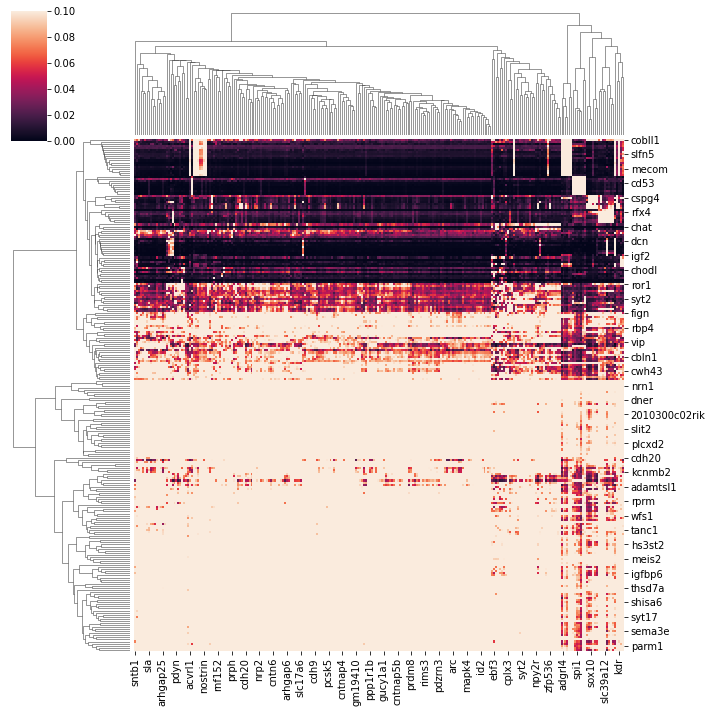

In [104]:
minexp=0
# Modify inner code
# Set threshold parameters
min_number_cells=10 #minimum number of cells belonging to a cluster to consider it in the analysis
minimum_exp=0.05 #maximum relative expression allowed in a gene in a cluster to consider the gene-celltype pair the analysis 

# Subset adata_sc to genes of spatial data
adata_sp = adata_sp[:,adata_sp.var_names.isin(adata_sc.var_names)]
adata_sc = adata_sc[:,adata_sp.var_names]
# TMP fix for sparse matrices, ideally we don't convert, and instead have calculations for sparse/non-sparse
#for a in [adata_sc, adata_sp]:
#    if issparse(a.X):
#        a.X = a.X.toarray()
print(adata_sp.shape)
print(adata_sc.shape)

print(adata_sc.var.index)
# Get mean expression per cell type
try:
    exp_sc=pd.DataFrame(adata_sc.X.todense(),columns=adata_sc.var_names)
except:
    exp_sc=pd.DataFrame(adata_sc.X,columns=adata_sc.var_names)
try: 
    exp_sp = pd.DataFrame(adata_sp.X.todense(),columns=adata_sp.var_names)
except:
    exp_sp = pd.DataFrame(adata_sp.X,columns=adata_sp.var_names)
print(exp_sc.shape)
#exp_sc['celltype'] = list(adata_sc.obs[key])
#exp_sp['celltype'] = list(adata_sp.obs[key])
# instead of measuring the purity by cell type, we check it based on the proportion of posive cells

#mean_celltype_sc = exp_sc.groupby('celltype').mean()
#mean_celltype_sp = exp_sp.groupby('celltype').mean()
mean_celltype_sc=coexpression_calculation(exp_sc,min_exp=minexp)
mean_celltype_sp=coexpression_calculation(exp_sp,min_exp=minexp)

# Get mean expressions relative to mean over cell types (this will be used for filtering based on minimum_exp)
mean_ct_sc_rel = mean_celltype_sc#.div(mean_celltype_sc.mean(axis=0),axis=1)
mean_ct_sp_rel = mean_celltype_sp#.div(mean_celltype_sp.mean(axis=0),axis=1)

# Get normalized mean expressions over cell types (this will be summed up over negative cell types)
mean_ct_sc_norm = mean_celltype_sc#.div(mean_celltype_sc.sum(axis=0),axis=1)
mean_ct_sp_norm = mean_celltype_sp#.div(mean_celltype_sp.sum(axis=0),axis=1)
# Explanation: The idea is to measure which ratio of mean expressions is shifted towards negative clusters.
#              With this approach the metric stays between 0 and 1

commongenes=mean_ct_sc_rel.index
# Get gene-cell type pairs with negative marker expression
neg_marker_mask = np.array(mean_ct_sc_rel < minimum_exp)
sns.clustermap(mean_ct_sc_rel.astype(float),vmax=0.1)
# Return nan if no negative markers were found

In [137]:
mean_ct_sc_rel

,2010300c02rik,acsbg1,acta2,acvrl1,adamts2,adamtsl1,adgrl4,aldh1a2,angpt1,ano1,...,trp73,trpc4,unc13c,vat1l,vip,vwc2l,wfs1,zfp366,zfp536,zfpm2
2010300c02rik,1.000000,0.188929,0.265928,0.500000,0.589166,0.557585,0.211466,0.425170,0.559688,0.157735,...,0.498965,0.608198,0.421521,0.560770,0.493182,0.475463,0.741583,0.259115,0.364424,0.615337
acsbg1,0.003738,1.000000,0.058172,0.004241,0.007276,0.007504,0.007519,0.000000,0.016617,0.011628,...,0.006211,0.004828,0.015939,0.005980,0.008066,0.004298,0.008753,0.001302,0.008463,0.014706
acta2,0.000630,0.006961,1.000000,0.006785,0.001381,0.003233,0.014098,0.003401,0.005080,0.057634,...,0.000414,0.000923,0.001102,0.000674,0.000796,0.000880,0.001213,0.009115,0.000670,0.000959
acvrl1,0.007731,0.003315,0.044321,1.000000,0.004780,0.012185,0.362782,0.006803,0.003788,0.028817,...,0.007453,0.006981,0.014581,0.007680,0.006872,0.018296,0.009294,0.348958,0.003432,0.005841
adamts2,0.072749,0.045409,0.072022,0.038168,1.000000,0.096060,0.037594,0.112245,0.144690,0.035389,...,0.165217,0.075510,0.098967,0.116718,0.049698,0.100319,0.114216,0.041667,0.054881,0.058953
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
vwc2l,0.152352,0.069606,0.119114,0.379135,0.260329,0.176556,0.082707,0.204082,0.269706,0.110212,...,0.291511,0.181663,0.280296,0.227163,0.260715,1.000000,0.203410,0.082031,0.148387,0.143988
wfs1,0.224465,0.133908,0.155125,0.181934,0.279979,0.189924,0.107143,0.173469,0.245684,0.105157,...,0.255901,0.196424,0.187044,0.249982,0.149781,0.192146,1.000000,0.115885,0.140279,0.157064
zfp366,0.001305,0.000331,0.019391,0.113656,0.001699,0.001713,0.393797,0.000000,0.001851,0.030334,...,0.002484,0.001830,0.004100,0.001436,0.001953,0.001289,0.001928,1.000000,0.001436,0.001532
zfp536,0.174785,0.205171,0.135734,0.106446,0.213170,0.313346,0.100564,0.333333,0.273408,0.477250,...,0.169772,0.332421,0.277529,0.303108,0.472601,0.222106,0.222280,0.136719,1.000000,0.218290


In [131]:
neg_marker_df=mean_ct_sc_rel<0.005

In [132]:
stacked_negative=pd.DataFrame(neg_marker_df.stack())

In [138]:
stacked_negative[0]

2010300c02rik  2010300c02rik    False
               acsbg1           False
               acta2            False
               acvrl1           False
               adamts2          False
                                ...  
zfpm2          vwc2l            False
               wfs1             False
               zfp366           False
               zfp536           False
               zfpm2            False
Name: 0, Length: 61504, dtype: bool

In [141]:
impossible_comb=stacked_negative[stacked_negative[0]==True]

In [163]:
expr=(adata_sp.to_df()>0)*1

In [172]:
adata_sp.obs['negative_purity_values']=0
adata_sp.obs['negative_purity_potential']=0
for r in tqdm(impossible_comb.index):
    g1=r[0]
    g2=r[1]
    sumu=np.sum(expr.loc[:,[g1,g2]],axis=1)
    adata_sp.obs['negative_purity_potential']=adata_sp.obs['negative_purity_potential']+(sumu>0)*1
#    print(np.sum(adata_sp.obs['negative_purity_values']))
    adata_sp.obs['negative_purity_values']=adata_sp.obs['negative_purity_values']+(sumu>1)*1

100%|███████████████████████████████████████████████████████████████████████████████| 7366/7366 [05:54<00:00, 20.79it/s]


In [177]:
adata_sp.obs['negative_purity_ratio']=1-(adata_sp.obs['negative_purity_values']/adata_sp.obs['negative_purity_potential'])

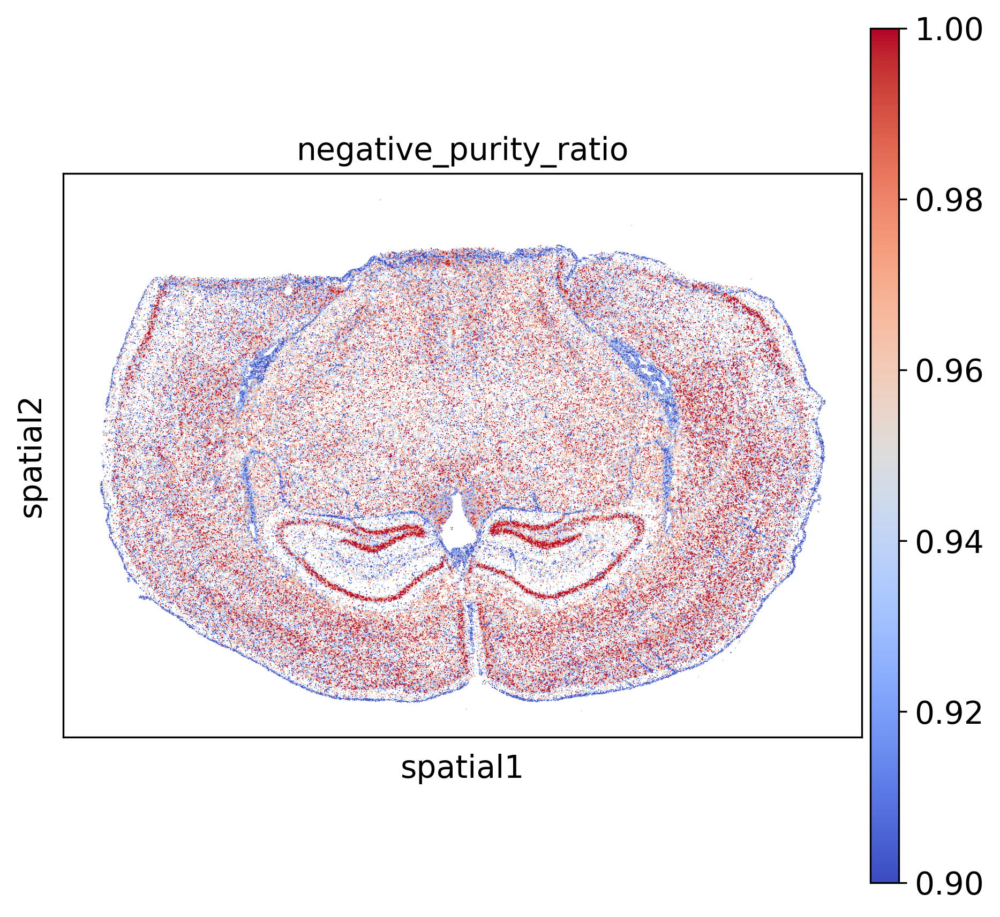

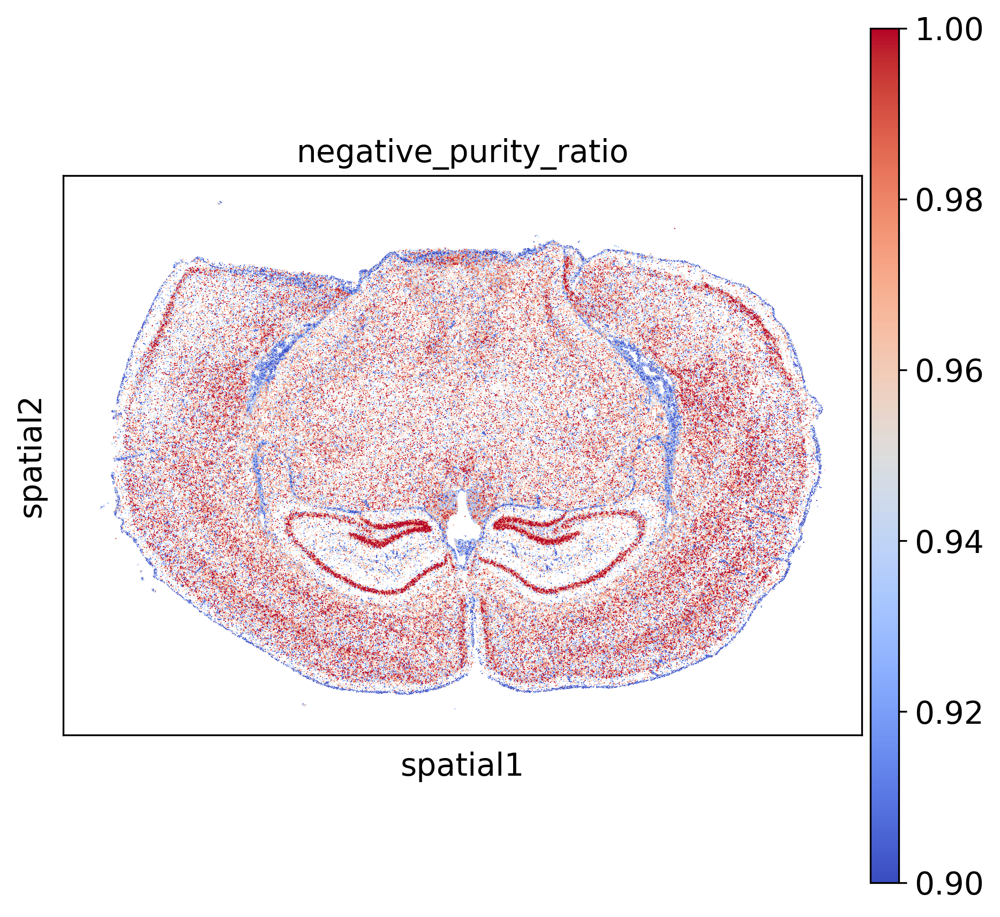

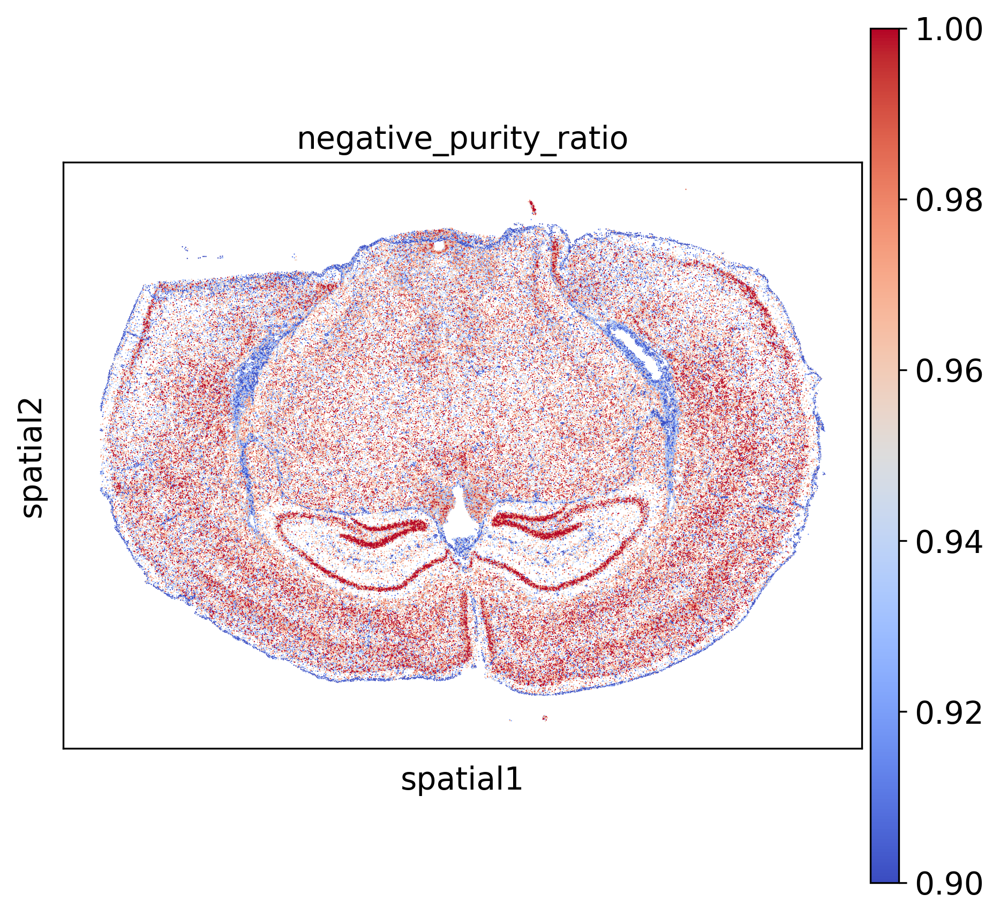

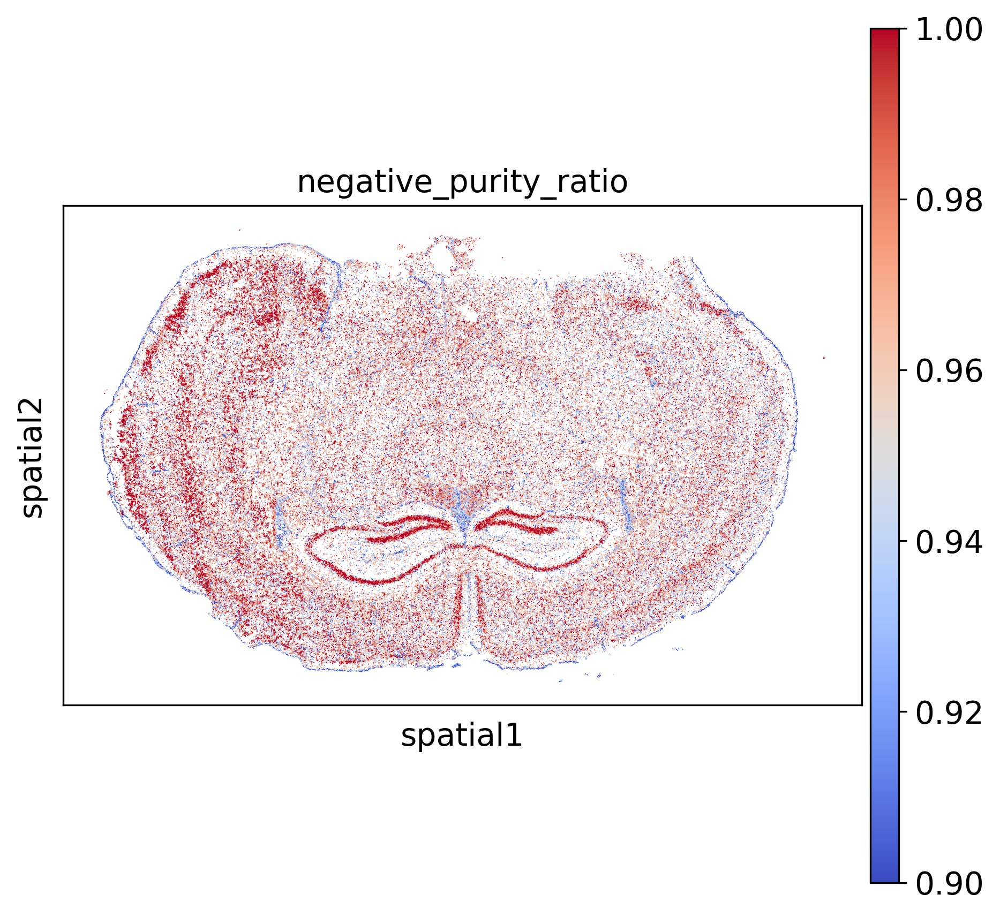

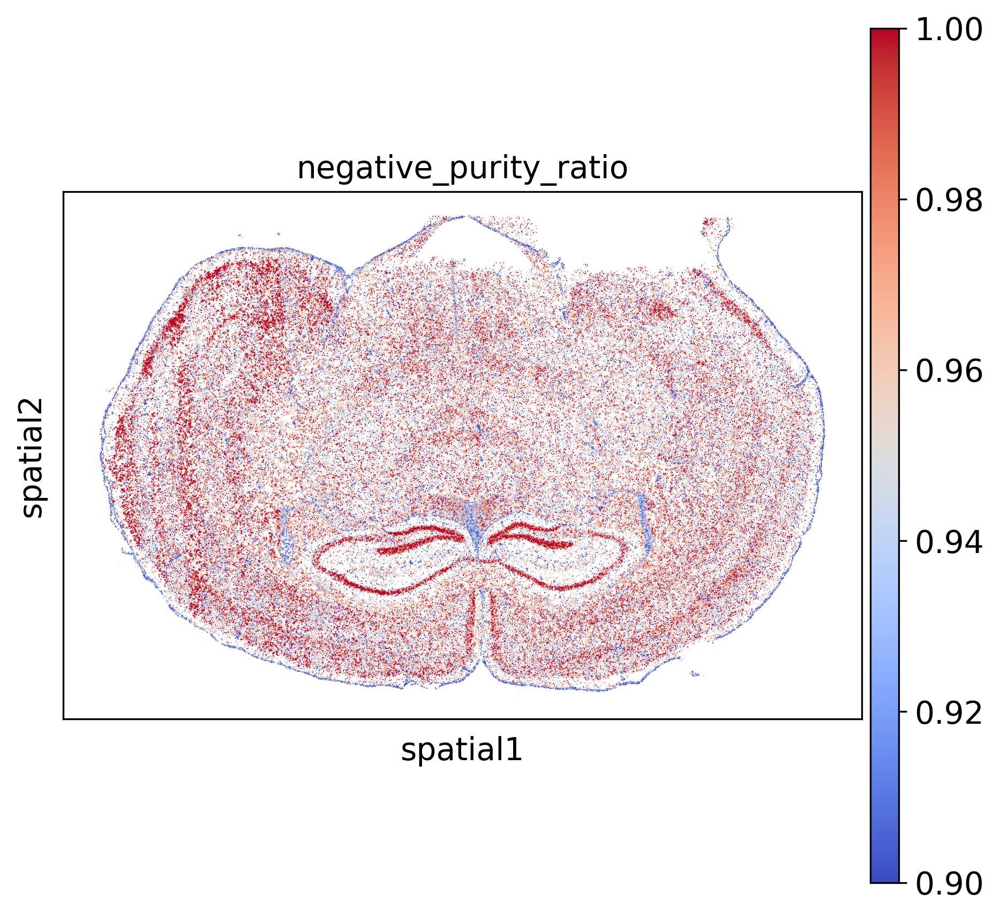

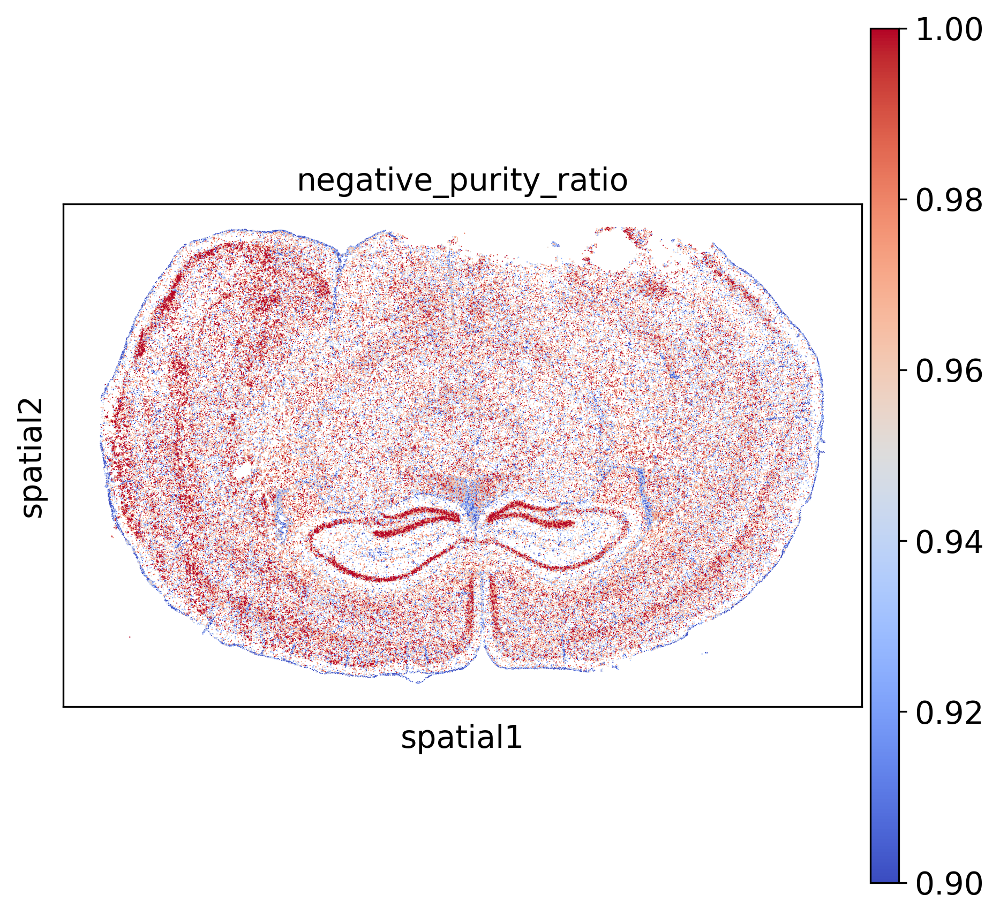

KeyboardInterrupt: 

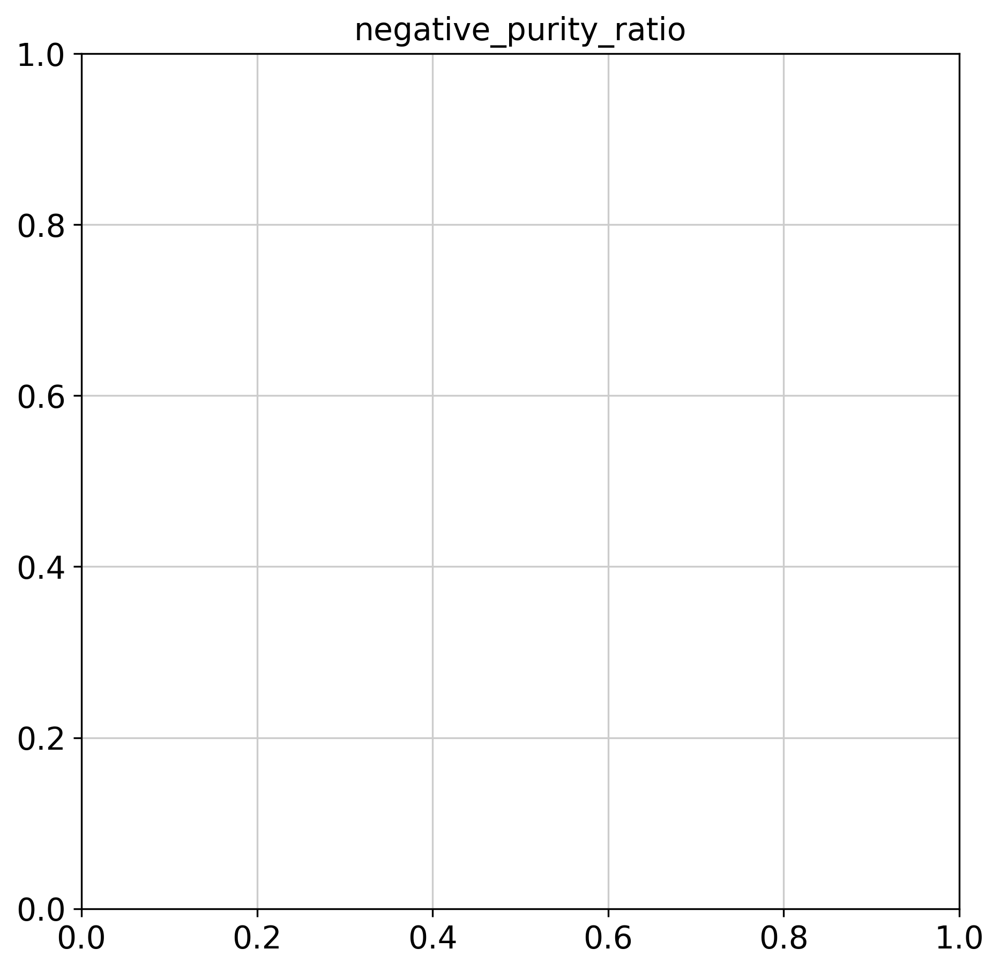

In [181]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(7,7))
plt.rcParams['figure.facecolor'] = 'white'
#level of annotation to work on
annot='Class'
for ss in adata_sp.obs['replicate'].unique():
    asub=adata_sp[adata_sp.obs['replicate']==ss]
    asub.obsm['spatial']=np.array(asub.obs.loc[:,['X','Y']])
    sc.pl.spatial(asub,color='negative_purity_ratio',spot_size=80,vmax=1,vmin=0.9,cmap='coolwarm')

In [223]:
adata.obs['negative_purity_ratio']=adata_sp.obs['negative_purity_ratio']
adata.obs['negative_purity_values']=adata_sp.obs['negative_purity_values']
adata.obs['negative_purity_potential']=adata_sp.obs['negative_purity_potential']

# Comparing with other magnitudes

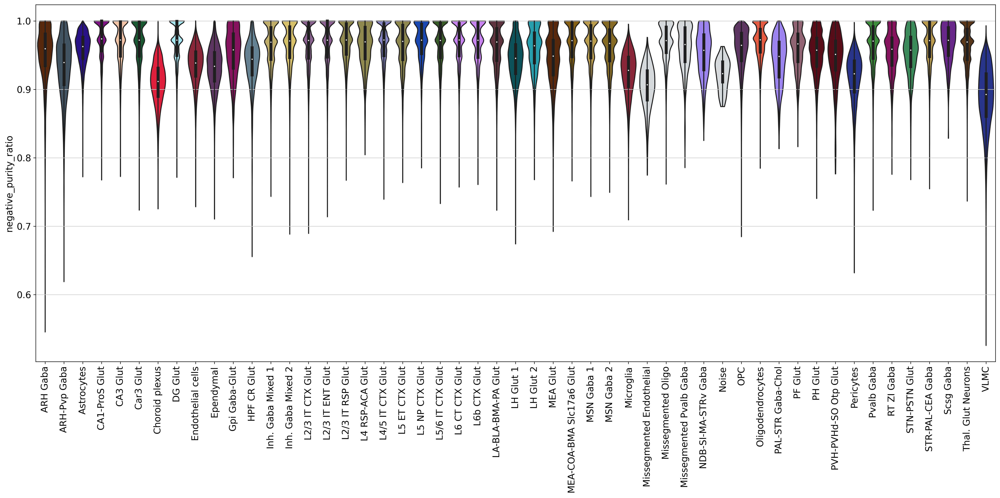

In [218]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(20,10))
sc.pl.violin(adata,'negative_purity_ratio',groupby='Class',swap_axes=True, rotation=90,size=1,stripplot=False, inner='box')
sc.set_figure_params(scanpy=True, dpi=150,figsize=(7,7))

In [196]:
adatasubsample=adata.copy()

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [197]:
sc.pp.subsample(adatasubsample,0.1)

In [201]:
adatasubsample.obs=adatasubsample.obs.reset_index()

In [211]:
np.corrcoef(adata.obs['neighborhood_density'],adata.obs['negative_purity_ratio'])[0,1]

-0.0048963752154051994

In [212]:
np.corrcoef(adata.obs['neighborhood_diversity'],adata.obs['negative_purity_ratio'])[0,1]

-0.0363338761928027

/home/sergio/anaconda3/envs/xb/lib/python3.7/site-packages/seaborn/distributions.py:316: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  warnings.warn(msg, UserWarning)


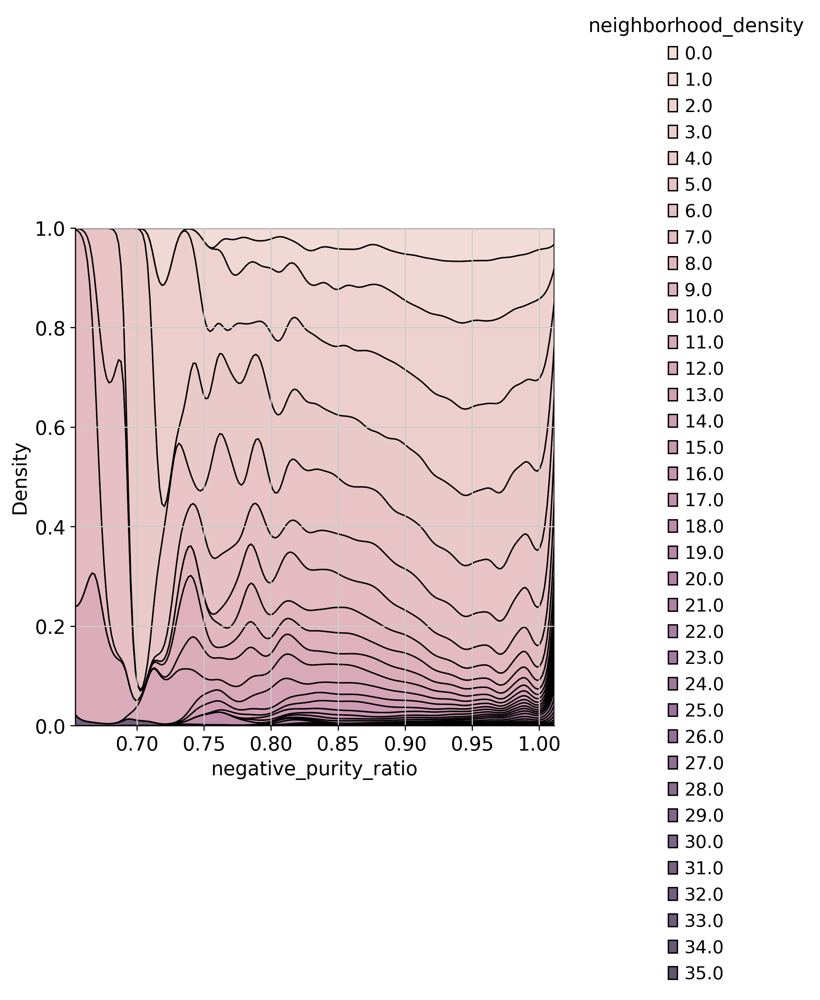

In [206]:
sns.displot(data=adatasubsample.obs,hue='neighborhood_density', x='negative_purity_ratio',kind="kde", height=6,
    multiple="fill")

In [224]:
saving_path=r'../../data/processed_adata/'
adata.write(saving_path+'/adata_multisection_nuclei_3rep_withHM_withclusters_withNMP.h5ad')